<a href="https://colab.research.google.com/github/Supakrit65/NetVisoo/blob/main/netvisoo_v3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Mount the folder containing the CICIDS2017 directory, which consists of 8 CSV files. You can download the dataset from https://www.kaggle.com/datasets/cicdataset/cicids2017/data, where the 8 CSV files are located in the MachineLearningCSV/MachineLearningCVE folder. In my case, the group-project directory already contains the CICIDS2017 folder with the 8 CSV files.

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

import os
os.chdir("/content/drive/MyDrive/KU-ML/ske-da/group-project/")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!ls

catboost_info  CICIDS2017  CICIDS2017_improved	netvisoo  netvisoo_v2.ipynb


In [ ]:
import json
import numpy as np
import pandas as pd
from itertools import combinations
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from imblearn.under_sampling import NearMiss
from sklearn.preprocessing import RobustScaler
from umap import UMAP
from imblearn.combine import SMOTETomek
# from catboost import CatBoostClassifier
from sklearn.metrics import classification_report, confusion_matrix

import seaborn as sns
import matplotlib.pyplot as plt

## Load and join datasets

In [ ]:
dataset_csv_path = 'CICIDS2017/'

# Get a list of all files and directories within the dataset path
all_items = os.listdir(dataset_csv_path)

# Filter out only the CSV files
csv_files = [item for item in all_items if item.endswith('.csv')]

# Construct full paths for each CSV file
complete_paths = [os.path.join(dataset_csv_path, csv_file) for csv_file in csv_files]

# Print the complete paths
print(complete_paths)

['CICIDS2017/Friday-WorkingHours-Afternoon-DDos.pcap_ISCX.csv', 'CICIDS2017/Friday-WorkingHours-Afternoon-PortScan.pcap_ISCX.csv', 'CICIDS2017/Friday-WorkingHours-Morning.pcap_ISCX.csv', 'CICIDS2017/Monday-WorkingHours.pcap_ISCX.csv', 'CICIDS2017/Thursday-WorkingHours-Afternoon-Infilteration.pcap_ISCX.csv', 'CICIDS2017/Thursday-WorkingHours-Morning-WebAttacks.pcap_ISCX.csv', 'CICIDS2017/Tuesday-WorkingHours.pcap_ISCX.csv', 'CICIDS2017/Wednesday-workingHours.pcap_ISCX.csv']


In [ ]:
df = pd.concat(map(pd.read_csv, complete_paths), ignore_index=True)
df

,Destination Port,Flow Duration,Total Fwd Packets,Total Backward Packets,Total Length of Fwd Packets,Total Length of Bwd Packets,Fwd Packet Length Max,Fwd Packet Length Min,Fwd Packet Length Mean,Fwd Packet Length Std,...,min_seg_size_forward,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Label
0,54865,3,2,0,12,0,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
1,55054,109,1,1,6,6,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
2,55055,52,1,1,6,6,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
3,46236,34,1,1,6,6,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
4,54863,3,2,0,12,0,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2830738,53,32215,4,2,112,152,28,28,28.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
2830739,53,324,2,2,84,362,42,42,42.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
2830740,58030,82,2,1,31,6,31,0,15.5,21.92031,...,32,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
2830741,53,1048635,6,2,192,256,32,32,32.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN


In [ ]:
df.shape

(2830743, 79)

In [ ]:
# rename columns to remove spaces
df.columns = df.columns.str.replace(' ', '')

## Basic EDA

In [ ]:
df.columns

Index(['DestinationPort', 'FlowDuration', 'TotalFwdPackets',
       'TotalBackwardPackets', 'TotalLengthofFwdPackets',
       'TotalLengthofBwdPackets', 'FwdPacketLengthMax', 'FwdPacketLengthMin',
       'FwdPacketLengthMean', 'FwdPacketLengthStd', 'BwdPacketLengthMax',
       'BwdPacketLengthMin', 'BwdPacketLengthMean', 'BwdPacketLengthStd',
       'FlowBytes/s', 'FlowPackets/s', 'FlowIATMean', 'FlowIATStd',
       'FlowIATMax', 'FlowIATMin', 'FwdIATTotal', 'FwdIATMean', 'FwdIATStd',
       'FwdIATMax', 'FwdIATMin', 'BwdIATTotal', 'BwdIATMean', 'BwdIATStd',
       'BwdIATMax', 'BwdIATMin', 'FwdPSHFlags', 'BwdPSHFlags', 'FwdURGFlags',
       'BwdURGFlags', 'FwdHeaderLength', 'BwdHeaderLength', 'FwdPackets/s',
       'BwdPackets/s', 'MinPacketLength', 'MaxPacketLength',
       'PacketLengthMean', 'PacketLengthStd', 'PacketLengthVariance',
       'FINFlagCount', 'SYNFlagCount', 'RSTFlagCount', 'PSHFlagCount',
       'ACKFlagCount', 'URGFlagCount', 'CWEFlagCount', 'ECEFlagCount',
       '

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2830743 entries, 0 to 2830742
Data columns (total 79 columns):
 #   Column                   Dtype  
---  ------                   -----  
 0   DestinationPort          int64  
 1   FlowDuration             int64  
 2   TotalFwdPackets          int64  
 3   TotalBackwardPackets     int64  
 4   TotalLengthofFwdPackets  int64  
 5   TotalLengthofBwdPackets  int64  
 6   FwdPacketLengthMax       int64  
 7   FwdPacketLengthMin       int64  
 8   FwdPacketLengthMean      float64
 9   FwdPacketLengthStd       float64
 10  BwdPacketLengthMax       int64  
 11  BwdPacketLengthMin       int64  
 12  BwdPacketLengthMean      float64
 13  BwdPacketLengthStd       float64
 14  FlowBytes/s              float64
 15  FlowPackets/s            float64
 16  FlowIATMean              float64
 17  FlowIATStd               float64
 18  FlowIATMax               int64  
 19  FlowIATMin               int64  
 20  FwdIATTotal              int64  
 21  FwdIATMe

In [ ]:
import plotly.express as px

# Calculate value counts
value_counts = df['Label'].value_counts()

# Create the pie chart
fig = px.pie(value_counts, values=value_counts.values, names=value_counts.index,
             title='Distribution of Labels')
fig.show()

In [ ]:
df.Label.value_counts()

Label
BENIGN                        2273097
DoS Hulk                       231073
PortScan                       158930
DDoS                           128027
DoS GoldenEye                   10293
FTP-Patator                      7938
SSH-Patator                      5897
DoS slowloris                    5796
DoS Slowhttptest                 5499
Bot                              1966
Web Attack � Brute Force         1507
Web Attack � XSS                  652
Infiltration                       36
Web Attack � Sql Injection         21
Heartbleed                         11
Name: count, dtype: int64

In [ ]:
df.dtypes

DestinationPort              int64
FlowDuration                 int64
TotalFwdPackets              int64
TotalBackwardPackets         int64
TotalLengthofFwdPackets      int64
                            ...   
IdleMean                   float64
IdleStd                    float64
IdleMax                      int64
IdleMin                      int64
Label                       object
Length: 79, dtype: object

In [ ]:
df.isnull().sum()

DestinationPort            0
FlowDuration               0
TotalFwdPackets            0
TotalBackwardPackets       0
TotalLengthofFwdPackets    0
                          ..
IdleMean                   0
IdleStd                    0
IdleMax                    0
IdleMin                    0
Label                      0
Length: 79, dtype: int64

In [ ]:
def null_value_analysis(df):
    total_rows = df.shape[0]
    null_columns = []

    for column in df.columns:
        null_count = df[column].isnull().sum()
        if null_count > 0:
            null_percentage = (null_count / total_rows) * 100
            null_columns.append((column, null_count, null_percentage))

    if null_columns:
        print("Columns with null values:")
        for column, count, percentage in null_columns:
            print(f"Column: {column}")
            print(f"Null Count: {count}")
            print(f"Null Percentage: {percentage:.2f}%")
            print()
    else:
        print("No columns with null values found.")

print("Null value analysis for the dataset:")
null_value_analysis(df)

Null value analysis for the dataset:
Columns with null values:
Column: FlowBytes/s
Null Count: 1358
Null Percentage: 0.05%



In [ ]:
def duplicate_row_analysis(df):
    total_rows = df.shape[0]
    duplicate_rows = df[df.duplicated()]
    duplicate_count = duplicate_rows.shape[0]

    if duplicate_count > 0:
        duplicate_percentage = (duplicate_count / total_rows) * 100
        print("Duplicate Row Analysis:")
        print(f"Total Rows: {total_rows}")
        print(f"Duplicate Rows: {duplicate_count}")
        print(f"Duplicate Percentage: {duplicate_percentage:.2f}%")
        print("\nDuplicate Rows:")
        print(duplicate_rows)
    else:
        print("No duplicate rows found.")

duplicate_row_analysis(df)

Duplicate Row Analysis:
Total Rows: 2830743
Duplicate Rows: 308381
Duplicate Percentage: 10.89%

Duplicate Rows:
         DestinationPort  FlowDuration  TotalFwdPackets  TotalBackwardPackets  \
2109                  80            77                2                     0   
2257                 443             3                2                     0   
2749                 443            49                2                     0   
2862                 443             4                2                     0   
2877                 443             1                2                     0   
...                  ...           ...              ...                   ...   
2830701               53           179                2                     2   
2830725               53           161                2                     2   
2830726               53           212                2                     2   
2830731              443             3                2                     0

## Perform Data Cleaning

In [ ]:
def clean_df(df):
    # Remove the space before each feature names
    df.columns = df.columns.str.strip()
    print('dataset shape', df.shape)

    # This set of feature should have >= 0 values
    num = df._get_numeric_data()
    num[num < 0] = 0

    zero_variance_cols = []
    for col in df.columns:
        if len(df[col].unique()) == 1:
            zero_variance_cols.append(col)
    df.drop(zero_variance_cols, axis = 1, inplace = True)
    print('zero variance columns', zero_variance_cols, 'dropped')
    print('shape after removing zero variance columns:', df.shape)

    df.replace([np.inf, -np.inf], np.nan, inplace = True)
    print(df.isna().any(axis = 1).sum(), 'rows dropped')
    df.dropna(inplace = True)
    print('shape after removing nan:', df.shape)

    # Drop duplicate rows
    df.drop_duplicates(inplace = True)
    print('shape after dropping duplicates:', df.shape)

    column_pairs = [(i, j) for i, j in combinations(df, 2) if df[i].equals(df[j])]
    ide_cols = []
    for column_pair in column_pairs:
        ide_cols.append(column_pair[1])
    df.drop(ide_cols, axis = 1, inplace = True)
    print('columns which have identical values', column_pairs, 'dropped')
    print('shape after removing identical value columns:', df.shape)
    return df
df = clean_df(df)

dataset shape (2830743, 79)
zero variance columns ['BwdPSHFlags', 'BwdURGFlags', 'FwdAvgBytes/Bulk', 'FwdAvgPackets/Bulk', 'FwdAvgBulkRate', 'BwdAvgBytes/Bulk', 'BwdAvgPackets/Bulk', 'BwdAvgBulkRate'] dropped
shape after removing zero variance columns: (2830743, 71)
2867 rows dropped
shape after removing nan: (2827876, 71)
shape after dropping duplicates: (2520798, 71)
columns which have identical values [('TotalFwdPackets', 'SubflowFwdPackets'), ('TotalBackwardPackets', 'SubflowBwdPackets'), ('FwdPSHFlags', 'SYNFlagCount'), ('FwdURGFlags', 'CWEFlagCount'), ('FwdHeaderLength', 'FwdHeaderLength.1')] dropped
shape after removing identical value columns: (2520798, 66)


In [ ]:
def group_label(label):
    attack_categories = {
        'BENIGN': 'Benign',
        'DoS Hulk': 'DoS/DDoS',
        'DoS GoldenEye': 'DoS/DDoS',
        'DoS slowloris': 'DoS/DDoS',
        'DoS Slowhttptest': 'DoS/DDoS',
        'DDoS': 'DoS/DDoS',
        'Heartbleed': 'DoS/DDoS',
        'PortScan': 'PortScan',
        'FTP-Patator': 'Brute Force',
        'SSH-Patator': 'Brute Force',
        'Web Attack � Brute Force': 'Web Attack',
        'Web Attack � XSS': 'Web Attack',
        'Web Attack � Sql Injection': 'Web Attack',
        'Bot': 'Botnet',
        'Infiltration': 'Benign'
    }

    df['label_category'] = df['Label'].map(attack_categories)
    return df

## Merging minority classes

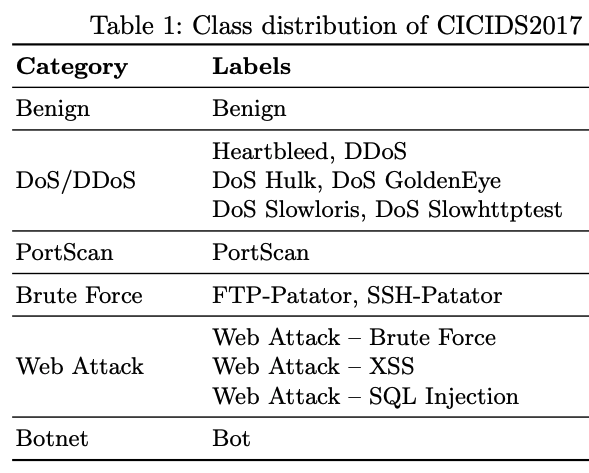

In [ ]:
df = group_label(df.copy())
df = df.drop('Label', axis=1)

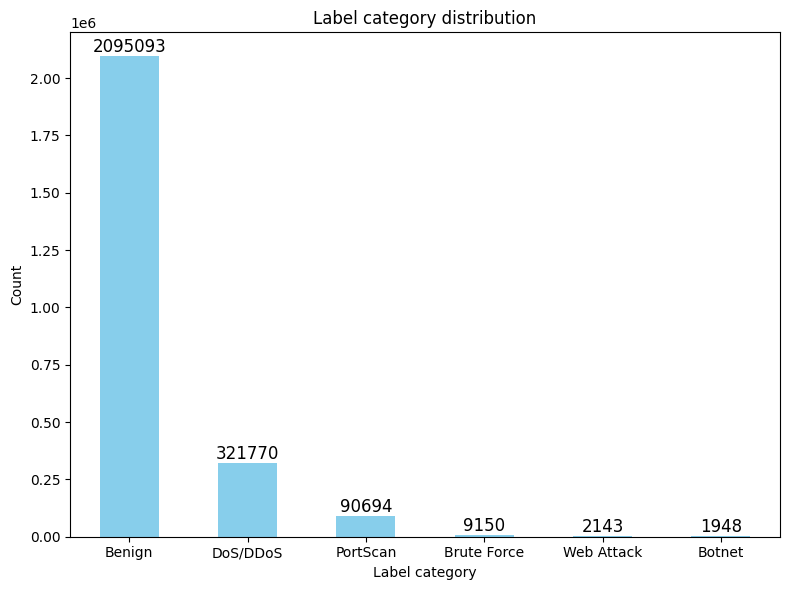

In [ ]:
# Count the number of occurrences for each label category
value_counts = df['label_category'].value_counts()

# Create a bar chart
plt.figure(figsize=(8, 6))
value_counts.plot(kind='bar', color='skyblue', title='Label category distribution')

# Add count on top of each bar
for i, v in enumerate(value_counts):
    plt.text(i, v + 0.1, str(v), ha='center', va='bottom', fontsize=12)

# Display the chart
plt.xlabel('Label category')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

## Stratified Random Sampling

Stratified random sampling allows researchers to obtain a sample population that best represents the entire population being studied.

In [ ]:
target_variable = 'label_category'

sample_ratio = 0.10
# Perform stratified random sampling
sampled_df = df.groupby(target_variable, group_keys=False).apply(lambda x: x.sample(frac=sample_ratio))

# Reset the index of the sampled dataframe
sampled_df.reset_index(drop=True, inplace=True)

In [ ]:
sampled_df.label_category.value_counts()

label_category
Benign         209509
DoS/DDoS        32177
PortScan         9069
Brute Force       915
Web Attack        214
Botnet            195
Name: count, dtype: int64

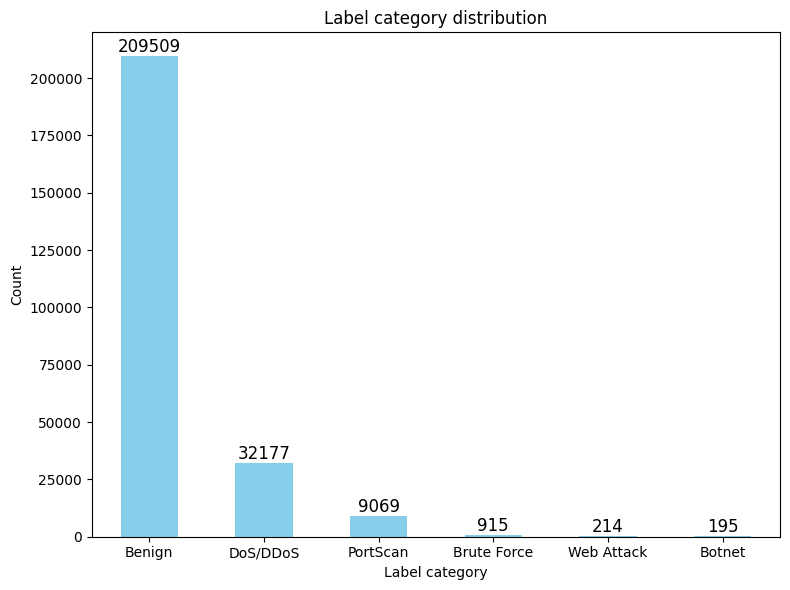

In [ ]:
# Count the number of occurrences for each label category
value_counts = sampled_df['label_category'].value_counts()

# Create a bar chart
plt.figure(figsize=(8, 6))
value_counts.plot(kind='bar', color='skyblue', title='Label category distribution')

# Add count on top of each bar
for i, v in enumerate(value_counts):
    plt.text(i, v + 0.1, str(v), ha='center', va='bottom', fontsize=12)

# Display the chart
plt.xlabel('Label category')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

In [ ]:
sampled_df.shape

(252079, 66)

In [ ]:
# Separate features and target variable
X = sampled_df.drop(['label_category'], axis=1)
y = sampled_df['label_category']

## Split Train/Test

In [ ]:
# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

## Data Scaling with RobustScaler

In [ ]:
# Perform RobustScaling
scaler = RobustScaler()

# Fit and transform the training data
X_train_scaled = scaler.fit_transform(X_train)

# Transform the test data
X_test_scaled = scaler.transform(X_test)

## Dimension Reduction with UMAP

In [ ]:
# Initialize UMAP
umap = UMAP(n_components=25, n_jobs=-1)

# Fit and transform the scaled training data
X_train_umap = umap.fit_transform(X_train_scaled)

# Transform the scaled test data
X_test_umap = umap.transform(X_test_scaled)

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:274: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



In [ ]:
import plotly.express as px

# Create the scatter plot for training data
fig_train = px.scatter(
    x=X_train_umap[:, 0],
    y=X_train_umap[:, 1],
    color=y_train,
    title='UMAP Transformation - Training Data',
    labels={'x': 'UMAP Dimension 1', 'y': 'UMAP Dimension 2', 'color': 'Label'},
    color_continuous_scale='viridis'
)

# Update the layout
fig_train.update_layout(plot_bgcolor='white')

# Display the plot
fig_train.show()

## Class Balancing with SMOTE-Tomek

In [ ]:
# Initialize SMOTE-Tomek
smote_tomek = SMOTETomek(random_state=42)

# Apply SMOTE-Tomek oversampling to the UMAP-transformed training data
X_train_resampled, y_train_resampled = smote_tomek.fit_resample(X_train_umap, y_train)

In [ ]:
import plotly.express as px

# Visualize data before SMOTE-Tomek transformation
fig_before = px.scatter(x=X_train_umap[:, 0], y=X_train_umap[:, 1], color=y_train,
                        title='Data Visualization Before SMOTE-Tomek',
                        labels={'x': 'UMAP Dimension 1', 'y': 'UMAP Dimension 2', 'color': 'Label'},
                        color_discrete_sequence=px.colors.qualitative.Plotly)

# Visualize data after SMOTE-Tomek transformation
fig_after = px.scatter(x=X_train_resampled[:, 0], y=X_train_resampled[:, 1], color=y_train_resampled,
                       title='Data Visualization After SMOTE-Tomek',
                       labels={'x': 'UMAP Dimension 1', 'y': 'UMAP Dimension 2', 'color': 'Label'},
                       color_discrete_sequence=px.colors.qualitative.Plotly)

# Update layout
fig_before.update_layout(plot_bgcolor='white')
fig_after.update_layout(plot_bgcolor='white')

# Display the plots
fig_before.show()
fig_after.show()

<Axes: xlabel='label_category', ylabel='count'>

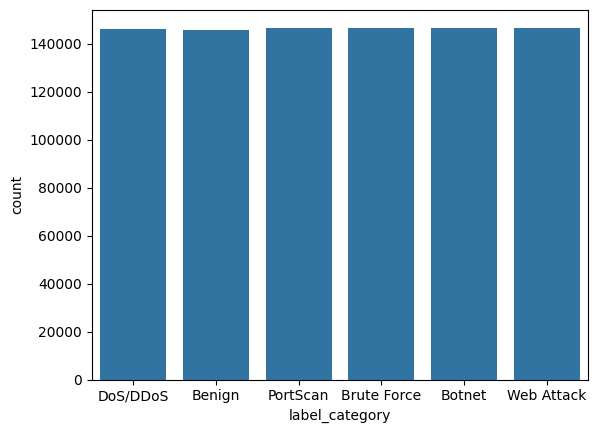

In [ ]:
df_resampled = pd.DataFrame({'label_category': y_train_resampled})

# Create the class distribution plot
sns.countplot(x='label_category', data=df_resampled)

## Single Model (CatBoost) Evaluation

Classification Report:
              precision    recall  f1-score   support

      Benign       1.00      0.95      0.97     62853
      Botnet       0.13      0.88      0.23        58
 Brute Force       0.72      0.97      0.83       275
    DoS/DDoS       0.87      0.98      0.92      9653
    PortScan       0.68      0.97      0.80      2721
  Web Attack       0.49      0.94      0.64        64

    accuracy                           0.95     75624
   macro avg       0.65      0.95      0.73     75624
weighted avg       0.97      0.95      0.96     75624



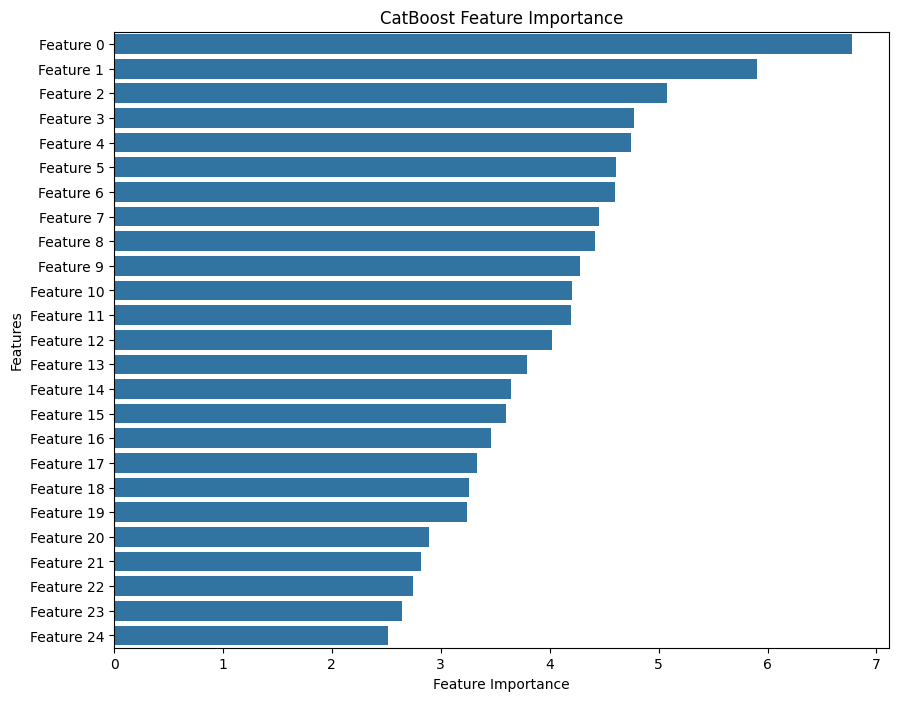

In [ ]:
from catboost import CatBoostClassifier
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
from sklearn.metrics import precision_recall_curve, average_precision_score
import plotly.graph_objects as go

# Initialize CatBoost classifier
catboost_model = CatBoostClassifier(random_state=42)

# Train the CatBoost model
catboost_model.fit(X_train_resampled, y_train_resampled, verbose=0)

# Predict on the test data
y_pred = catboost_model.predict(X_test_umap)

# Print classification report
print("Classification Report:")
print(classification_report(y_test, y_pred))

# Confusion matrix
cm = confusion_matrix(y_test, y_pred)
classes = ['Benign', 'Botnet', 'Brute Force', 'DoS/DDoS', 'PortScan', 'Web Attack']

# Create a heatmap trace for the confusion matrix
trace = go.Heatmap(
    z=cm,
    x=classes,
    y=classes,
    colorscale='Blues',
    text=[[str(y) for y in x] for x in cm],
    texttemplate="%{text}",
    textfont={"size": 14},
    hoverinfo='text',
    hovertext=[['True: {}<br>Predicted: {}<br>Count: {}'.format(classes[i], classes[j], cm[i][j])
                for j in range(len(classes))]
               for i in range(len(classes))],
    colorbar=dict(title="Count"),
    showscale=True
)

# Create the layout for the plot
layout = go.Layout(
    title='Confusion Matrix',
    xaxis=dict(title='Predicted'),
    yaxis=dict(title='True'),
    width=600,
    height=600,
    template='plotly_white'
)

# Create the Figure object and display the plot
fig = go.Figure(data=[trace], layout=layout)
fig.show()

# Feature importance
feature_importance = catboost_model.get_feature_importance(prettified=True)
plt.figure(figsize=(10, 8))
sns.barplot(x=feature_importance.Importances, y=[f"Feature {i}" for i in range(len(feature_importance))])
plt.xlabel("Feature Importance")
plt.ylabel("Features")
plt.title("CatBoost Feature Importance")
plt.show()

## Stacking Classifier Model Evaluation

In [ ]:
from catboost import CatBoostClassifier
import catboost as cb
from xgboost import XGBClassifier
from sklearn.ensemble import StackingClassifier, RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Initialize individual classifiers (with verbosity off)
catboost_model = CatBoostClassifier(random_state=42, verbose=0)
xgboost_model = XGBClassifier(random_state=42, verbosity=0)

# Define the base models
base_models = [
    ('catboost', catboost_model),
    ('xgboost', xgboost_model),
    ('lr', LogisticRegression(penalty='l1', solver='liblinear', random_state=42)),
]

# Define the meta model
meta_model = RandomForestClassifier(random_state=42)

# Define the stacking ensemble model
ensemble_model = StackingClassifier(
    estimators=base_models,
    final_estimator=meta_model,
    cv=5,
    stack_method='predict_proba'
)

# Train the ensemble model
ensemble_model.fit(X_train_resampled, y_train_resampled)

# Predict on the test data using the ensemble model
y_pred = ensemble_model.predict(X_test_umap)

# Evaluate the ensemble model
print("Classification Report:")
print(classification_report(y_test, y_pred))

# Confusion matrix
cm = confusion_matrix(y_test, y_pred)
classes = ['Benign', 'Botnet', 'Brute Force', 'DoS/DDoS', 'PortScan', 'Web Attack']

# Create a heatmap trace for the confusion matrix
trace = go.Heatmap(
    z=cm,
    x=classes,
    y=classes,
    colorscale='Blues',
    text=[[str(y) for y in x] for x in cm],
    texttemplate="%{text}",
    textfont={"size": 14},
    hoverinfo='text',
    hovertext=[['True: {}<br>Predicted: {}<br>Count: {}'.format(classes[i], classes[j], cm[i][j])
                for j in range(len(classes))]
               for i in range(len(classes))],
    colorbar=dict(title="Count"),
    showscale=True
)

# Create the layout for the plot
layout = go.Layout(
    title='Confusion Matrix',
    xaxis=dict(title='Predicted'),
    yaxis=dict(title='True'),
    width=600,
    height=600,
    template='plotly_white'
)

# Create the Figure object and display the plot
fig = go.Figure(data=[trace], layout=layout)
fig.show()

Classification Report:
              precision    recall  f1-score   support

      Benign       0.99      0.96      0.98     62853
      Botnet       0.21      0.83      0.33        58
 Brute Force       0.87      0.97      0.92       275
    DoS/DDoS       0.89      0.98      0.93      9653
    PortScan       0.75      0.95      0.84      2721
  Web Attack       0.85      0.89      0.87        64

    accuracy                           0.97     75624
   macro avg       0.76      0.93      0.81     75624
weighted avg       0.97      0.97      0.97     75624

